
<center>
<h1>Restaurant Crimes in Chicago</h1>
<p>Ricky Donnell Lindsey Jr.</>
<p>June 8, 2020</p>
</center>

<h2>1. Introduction</h3>
<h4>1.1 Background</h4>
The City of Chicago is the third most most populous city in the United States of America. Comprised of 77 community areas, with more than 7,300 restaurants. 
<h4>1.2 Problem</h4>
With an estimated population of 2,693,976, within 234 square miles of land, crime is inevitable. Understanding where crimes are most likely to occurn as well as what crimes is mostlikely to occur in a given location  is essential for any business owner. For this analysis the data will be approcahed from the perspective of a potential restaurateur, looking for a location to open a restaurant in Chicago.
<h2>2. Data Acquisition and Cleaning</h3>
<h4>2.1 Data Source<h4>
The City of Chicago uses the Chicago Open Data Portal to make much of it's public data easily accesible. The Chicago Crimes data set being used is an open source and can be found <a href="https://data.cityofchicago.org/Public-Safety/Crimes-2001-to-present/ijzp-q8t2">here</a>. The data set is a reflection of reported crimes in across Chicago from 2001 to present day. Data occasionally may be missing column data from a certain category but it is mostly complete for most entries. The data set tracks twenty-two features, however only ten will be used: ID,IUCR,Primary Type,Location Description,Arrest, Beat,District, Ward, Community Area and Year.
<h4>2.2 Data Cleaning<h4>
After Cleaning the data it has become quite cleasr that there is some trend in the crimes commited in Chicago and the ammount of crimes commited.

In [1]:
import pandas as pd 
import numpy as np 

df_crimes = pd.read_csv('Crimes_-_2001_to_present.csv', dtype=str,
    usecols=['ID','IUCR','Primary Type','Location Description','Arrest', 'Beat','District','Ward',  'Community Area','Year'])
df_crimes.head()

,ID,IUCR,Primary Type,Location Description,Arrest,Beat,District,Ward,Community Area,Year
0,11034701,1153,DECEPTIVE PRACTICE,RESIDENCE,false,0412,004,8,45,2001
1,11227287,0281,CRIM SEXUAL ASSAULT,RESIDENCE,false,2222,022,21,73,2017
2,11227583,0620,BURGLARY,OTHER,false,0835,008,18,70,2017
3,11227293,0810,THEFT,RESIDENCE,false,0313,003,20,42,2017
4,11227634,0281,CRIM SEXUAL ASSAULT,HOTEL/MOTEL,false,0122,001,42,32,2017


In [2]:
df_description = df_crimes.describe(include='all')
df_description

,ID,IUCR,Primary Type,Location Description,Arrest,Beat,District,Ward,Community Area,Year
count,7114996,7114996,7114996,7108363,7114996,7114996,7114949,6500169,6501511,7114996
unique,7114996,402,36,212,2,304,24,50,78,20
top,3335392,0820,THEFT,STREET,false,0423,008,28,25,2002
freq,1,579425,1504793,1849897,5166072,55231,481520,298157,411777,486762


In [3]:
print("The most common crime is %s. %.2f%% of crimes reported are %s."%(df_description['Primary Type']['top'], (df_description['Primary Type']['freq']/df_description['Primary Type']['count']*100), df_description['Primary Type']['top']))
print("The most common location is %s. %.2f%% of crimes reported occur in the %s."%(df_description['Location Description']['top'], (df_description['Primary Type']['freq']/df_description['Location Description']['count']*100), df_description['Location Description']['top']))

The most common crime is THEFT. 21.15% of crimes reported are THEFT
The most common location is STREET. 21.17% of crimes reported occur in the STREET


In [4]:
count_ptype = pd.value_counts(df_crimes['Primary Type'].values)
count_ptype

THEFT                                1504793
BATTERY                              1301613
CRIMINAL DAMAGE                       809139
NARCOTICS                             730762
ASSAULT                               447371
OTHER OFFENSE                         442257
BURGLARY                              401691
MOTOR VEHICLE THEFT                   327286
DECEPTIVE PRACTICE                    290993
ROBBERY                               267310
CRIMINAL TRESPASS                     202815
WEAPONS VIOLATION                      79677
PROSTITUTION                           69181
PUBLIC PEACE VIOLATION                 49813
OFFENSE INVOLVING CHILDREN             48972
CRIM SEXUAL ASSAULT                    28810
SEX OFFENSE                            27043
INTERFERENCE WITH PUBLIC OFFICER       17183
GAMBLING                               14575
LIQUOR LAW VIOLATION                   14361
ARSON                                  11698
HOMICIDE                               10213
KIDNAPPING

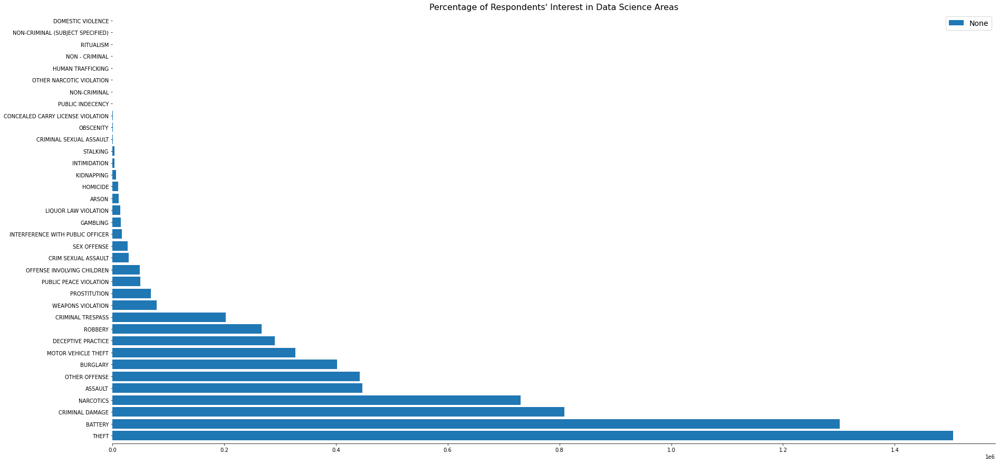

In [5]:
import matplotlib.pyplot as pplt

ax = count_ptype.plot(x=count_ptype[0], kind='barh', width=0.8, figsize=(30,15))
pplt.title("Percentage of Respondents' Interest in Data Science Areas", fontsize = 16)
pplt.legend(fontsize = 14)
pplt.yticks(fontsize = 10)
pplt.gca().spines['left'].set_visible(False)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

In [6]:
wards = np.arange(1,51).astype(str)
types = df_crimes['Primary Type'].unique()
df_count = pd.DataFrame(index=wards,columns=count_ptype.index)

for w in wards:
    temp= df_crimes[df_crimes["Ward"]==w]
    x = pd.value_counts(temp['Primary Type'].values)
    for p in x.index:
        df_count[p][w] = x.get(p)

df_count

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
1,42935,16366,15527,4962,6036,5177,9066,6374,5865,4543,...,15,2,1,3,6,NaN,1,NaN,NaN,NaN
2,75739,35594,19628,23809,13403,12256,6616,9311,14436,8153,...,23,8,11,10,7,8,1,NaN,NaN,NaN
3,31437,41932,17728,27318,13828,10662,7700,7645,6448,8501,...,26,9,7,4,3,3,2,NaN,1,NaN
4,29707,22660,12507,9940,8504,8458,6241,5415,5933,5115,...,17,4,4,2,NaN,1,NaN,NaN,NaN,NaN
5,29933,30654,17969,10826,10792,11122,11380,6843,6217,7372,...,10,6,3,4,1,2,1,1,NaN,NaN
6,35479,43032,23290,19299,15229,13639,12971,11424,8083,12039,...,10,30,3,1,1,3,NaN,NaN,NaN,NaN
7,25088,39038,20612,17113,13606,13046,12413,7216,4991,6622,...,14,11,4,NaN,3,3,NaN,1,NaN,NaN
8,29230,37157,20654,13967,13667,12695,12307,9242,6024,8444,...,14,15,5,1,NaN,2,NaN,3,NaN,NaN
9,23659,37446,20713,15168,13677,11817,9816,7188,4366,6375,...,15,18,3,3,2,2,2,1,1,NaN
10,17617,21898,17271,8980,9303,7980,7091,4355,3361,2987,...,7,8,NaN,3,2,2,1,1,NaN,NaN


In [7]:
df_count.astype(float).describe().round(2)

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,50.00,...,50.00,48.00,45.00,43.00,40.00,30.00,24.00,12.00,9.0,0.0
mean,27639.94,23664.98,14751.46,13268.80,8151.32,8053.42,7384.24,5888.42,5462.68,4881.18,...,12.72,11.81,3.71,3.98,3.20,2.10,1.58,1.25,1.0,NaN
std,19545.61,14705.28,5334.62,15339.17,4727.92,3407.12,3032.80,2446.62,4524.50,3111.48,...,4.61,16.08,3.94,4.20,3.12,1.45,0.97,0.62,0.0,NaN
min,11962.00,7132.00,6463.00,1280.00,2298.00,2995.00,2382.00,2144.00,1843.00,381.00,...,5.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,NaN
25%,17651.00,11339.50,10162.75,3612.50,3798.50,5206.25,4860.25,4018.75,3485.25,2333.25,...,10.00,3.00,2.00,2.00,1.00,1.00,1.00,1.00,1.0,NaN
50%,22275.50,16241.00,13251.00,6668.50,5992.00,6607.50,6495.50,5802.00,4474.00,3663.50,...,12.00,7.00,3.00,3.00,2.00,2.00,1.00,1.00,1.0,NaN
75%,29904.00,37264.25,20366.00,19470.00,13237.75,10881.00,9393.75,7634.75,6001.25,7303.75,...,15.00,14.00,4.00,4.00,3.25,2.75,2.00,1.00,1.0,NaN
max,137397.00,60726.00,24608.00,78619.00,18120.00,14360.00,13857.00,11424.00,33271.00,12578.00,...,26.00,91.00,26.00,23.00,14.00,8.00,4.00,3.00,1.0,NaN


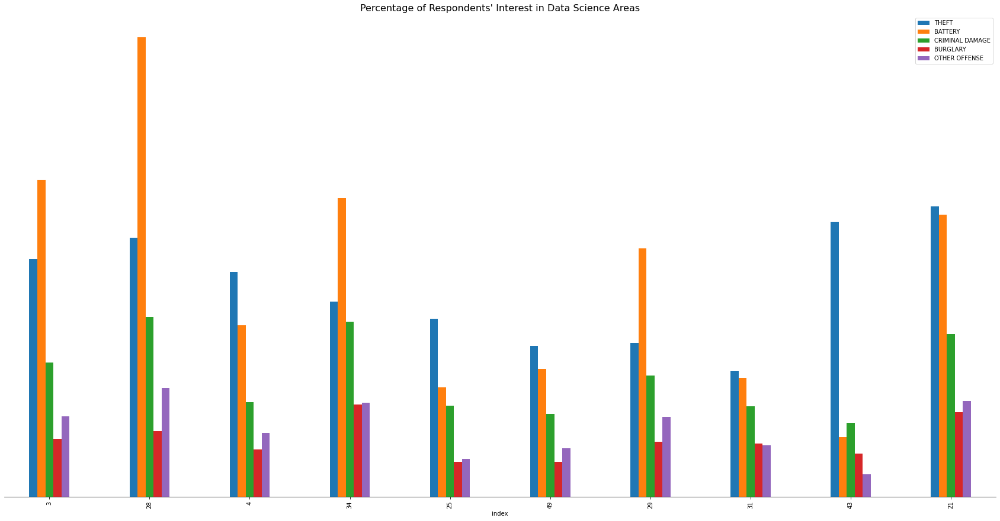

In [8]:
df_topFive = df_count[['THEFT', 'BATTERY', 'CRIMINAL DAMAGE', 'BURGLARY', 'OTHER OFFENSE']].reset_index().sample(10)
ax = df_topFive.plot(x='index',kind='bar', width=0.4,figsize=(30,15))
pplt.title("Percentage of Respondents' Interest in Data Science Areas", fontsize = 16)
pplt.legend(fontsize = 10)
pplt.xticks(fontsize = 10)
pplt.yticks([])
pplt.gca().spines['left'].set_visible(False)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

In [9]:
cAreas = np.arange(1,79).astype(str)
df_count2 = pd.DataFrame(index=cAreas,columns=count_ptype.index)

for w in cAreas:
    temp= df_crimes[df_crimes["Community Area"]==w]
    x = pd.value_counts(temp['Primary Type'].values)
    for p in x.index:
        df_count2[p][w] = x.get(p)

df_count2.head()

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
1,21580,18377,11858,9542,5912,6807,5201,2850,4262,4181,...,16,NaN,2,2,4,NaN,NaN,NaN,NaN,NaN
2,20134,12728,12345,4016,4473,6180,6025,3981,4043,2639,...,17,3,2,1,1,NaN,NaN,NaN,1,NaN
3,23174,16112,8737,10689,5871,5804,3686,3108,6098,2855,...,9,2,2,5,4,NaN,NaN,NaN,NaN,NaN
4,12715,6929,6427,1768,2296,3287,3145,2125,2713,1048,...,4,2,4,3,2,NaN,NaN,NaN,NaN,NaN
5,12308,3926,5219,1443,1592,2381,3641,1699,2621,872,...,10,NaN,1,3,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
df_count2.describe()

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,77,77,77,77,77,77,77,77,77,77,...,75,65,58,53,42,33,27,13,8,0
unique,77,77,76,77,77,76,77,77,76,77,...,21,21,9,11,9,6,4,2,2,0
top,39422,12799,4609,1916,1094,1225,766,2815,2678,9598,...,7,1,1,1,1,1,1,1,1,NaN
freq,1,1,2,1,1,2,1,1,2,1,...,8,18,22,18,20,20,21,11,7,NaN


In [11]:
df_count2.astype(float).describe().round(2)

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,77.00,77.00,77.00,77.00,77.00,77.00,77.00,77.00,77.00,77.00,...,75.00,65.00,58.00,53.00,42.00,33.00,27.00,13.00,8.00,0.0
mean,17957.44,15365.95,9579.31,8616.09,5292.83,5229.39,4793.90,3825.19,3550.29,3169.34,...,8.48,8.72,2.88,3.25,3.05,1.91,1.41,1.15,1.12,NaN
std,17590.85,14440.26,6762.73,13510.77,4596.92,4008.15,3766.19,2976.19,3675.50,3056.01,...,5.54,15.31,3.22,3.63,3.37,1.42,0.93,0.38,0.35,NaN
min,1372.00,1064.00,1271.00,83.00,351.00,685.00,320.00,175.00,236.00,37.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,NaN
25%,6759.00,4940.00,4204.00,1647.00,2108.00,2446.00,2083.00,1579.00,1596.00,875.00,...,4.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,NaN
50%,13447.00,10381.00,8088.00,3449.00,3628.00,4041.00,3661.00,2850.00,2693.00,2241.00,...,7.00,4.00,2.00,2.00,2.00,1.00,1.00,1.00,1.00,NaN
75%,22818.00,22570.00,13208.00,10689.00,7609.00,7378.00,6629.00,4876.00,4074.00,4605.00,...,12.00,9.00,3.00,3.00,3.75,2.00,1.00,1.00,1.00,NaN
max,94628.00,82659.00,36399.00,91824.00,25237.00,24819.00,16366.00,15755.00,22834.00,17582.00,...,27.00,91.00,18.00,20.00,16.00,6.00,5.00,2.00,2.00,NaN


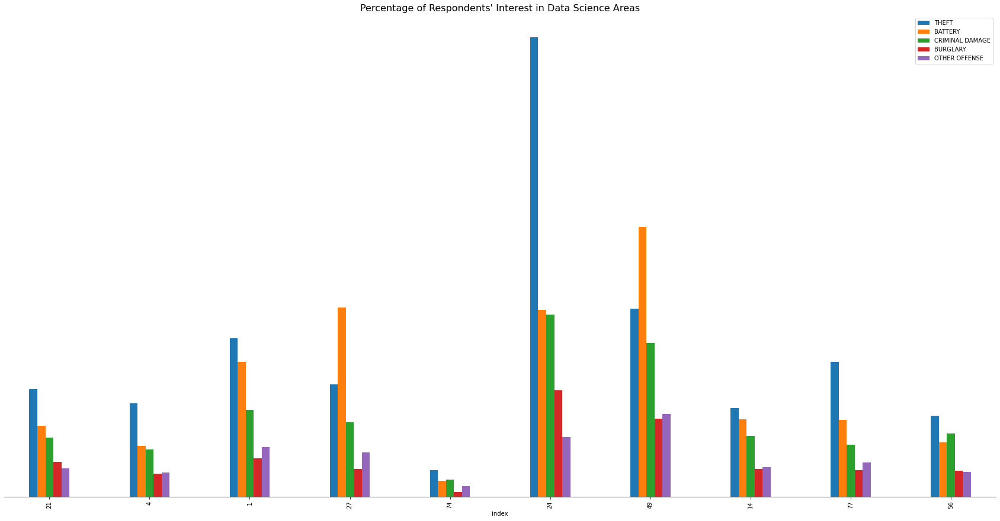

In [12]:
df_topFive = df_count2[['THEFT', 'BATTERY', 'CRIMINAL DAMAGE', 'BURGLARY', 'OTHER OFFENSE']].reset_index().sample(10)
ax = df_topFive.plot(x='index',kind='bar', width=0.4,figsize=(30,15))
pplt.title("Percentage of Respondents' Interest in Data Science Areas", fontsize = 16)
pplt.legend(fontsize = 10)
pplt.xticks(fontsize = 10)
pplt.yticks([])
pplt.gca().spines['left'].set_visible(False)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

In [13]:
beats = df_crimes.Beat.unique()
beats = [x for x in beats if str(x) != 'nan']
beats.sort(key=int)

In [14]:
df_count3 = pd.DataFrame(index=beats,columns=count_ptype.index)

for w in beats:
    temp= df_crimes[df_crimes["Beat"]==w]
    x = pd.value_counts(temp['Primary Type'].values)
    for p in x.index:
        df_count3[p][w] = x.get(p)

df_count3.head()

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
0111,16008,2132,1318,652,1149,1548,376,535,3160,653,...,5,NaN,2,1,3,1,NaN,NaN,NaN,NaN
0112,14730,1684,740,206,840,1253,310,223,3552,640,...,2,1,2,2,1,NaN,NaN,NaN,NaN,NaN
0113,9486,2075,972,416,1269,1135,322,228,3033,628,...,3,1,4,3,1,NaN,NaN,NaN,NaN,NaN
0114,4149,812,528,213,288,267,91,122,938,206,...,NaN,1,2,NaN,2,NaN,NaN,NaN,NaN,NaN
0121,3135,500,418,293,218,272,150,137,931,192,...,NaN,1,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN


In [15]:
df_count3.describe()

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,303,304,303,303,303,303,302,301,303,300,...,247,176,124,100,84,52,29,22,9,1
unique,294,300,292,293,287,283,285,280,273,274,...,9,15,6,6,7,3,3,2,1,1
top,11470,5230,3194,304,766,706,1,840,456,567,...,1,1,1,1,1,1,1,1,1,1
freq,2,2,2,3,2,4,3,3,4,3,...,70,75,88,61,56,43,22,21,9,1


In [16]:
df_count3.astype(float).describe().round(2)

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,303.00,304.00,303.00,303.00,303.00,303.00,302.00,301.00,303.00,300.00,...,247.00,176.00,124.00,100.00,84.00,52.00,29.00,22.00,9.0,1.0
mean,4966.31,4281.62,2670.43,2411.76,1476.47,1459.59,1330.10,1087.33,960.37,891.03,...,2.68,3.22,1.44,1.72,1.63,1.21,1.31,1.05,1.0,1.0
std,3079.58,2471.71,1294.16,2607.63,815.42,727.95,756.13,559.20,694.12,507.86,...,1.66,6.78,0.89,1.67,1.32,0.50,0.60,0.21,0.0,NaN
min,5.00,2.00,3.00,2.00,2.00,1.00,1.00,1.00,2.00,2.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.0
25%,3242.50,2333.00,1782.00,675.00,834.50,906.50,745.00,664.00,585.50,515.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.0
50%,4322.00,3995.50,2626.00,1646.00,1389.00,1408.00,1294.00,1044.00,826.00,826.50,...,2.00,2.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.0
75%,5604.00,5687.75,3503.50,3194.00,1950.00,1932.00,1821.50,1434.00,1140.50,1207.50,...,3.50,3.00,2.00,2.00,2.00,1.00,1.00,1.00,1.0,1.0
max,26041.00,13431.00,6928.00,18159.00,4616.00,3784.00,4113.00,2693.00,6035.00,2580.00,...,9.00,71.00,6.00,16.00,9.00,3.00,3.00,2.00,1.0,1.0


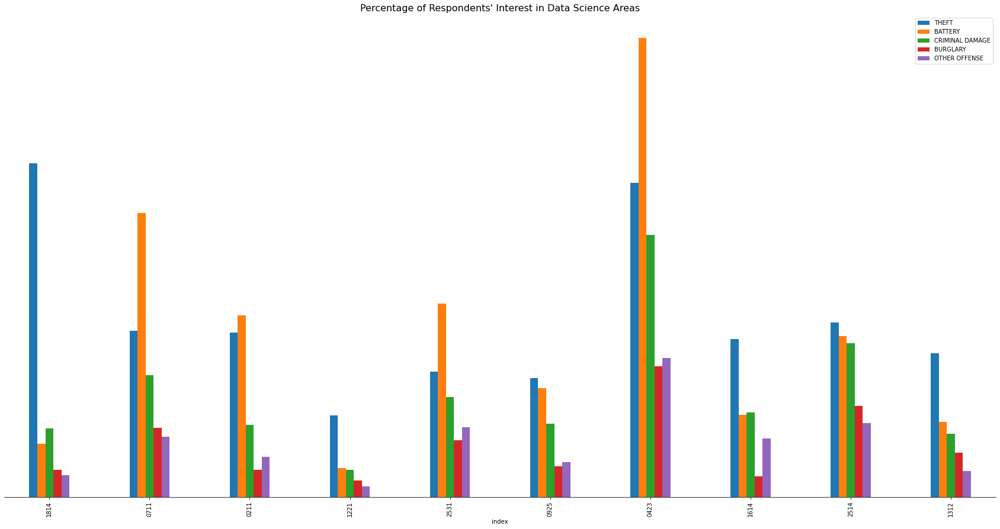

In [17]:
df_topFive = df_count3[['THEFT', 'BATTERY', 'CRIMINAL DAMAGE', 'BURGLARY', 'OTHER OFFENSE']].reset_index().sample(10)
ax = df_topFive.plot(x='index',kind='bar', width=0.4,figsize=(30,15))
pplt.title("Percentage of Respondents' Interest in Data Science Areas", fontsize = 16)
pplt.legend(fontsize = 10)
pplt.xticks(fontsize = 10)
pplt.yticks([])
pplt.gca().spines['left'].set_visible(False)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

In [18]:
location = df_crimes["Location Description"].unique()
location = [x for x in location if str(x) != 'nan']
location.sort()

In [19]:
df_count4 = pd.DataFrame(index=location,columns=count_ptype.index)

for w in location:
    temp= df_crimes[df_crimes["Location Description"]==w]
    x = pd.value_counts(temp['Primary Type'].values)
    for p in x.index:
        df_count4[p][w] = x.get(p)

df_count4.head()

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
ABANDONED BUILDING,1528,374,1051,2954,75,471,1890,16,86,156,...,NaN,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AIRCRAFT,341,137,8,5,36,34,NaN,NaN,21,NaN,...,NaN,NaN,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN
AIRPORT BUILDING NON-TERMINAL - NON-SECURE AREA,445,66,36,12,47,37,NaN,44,219,3,...,NaN,5,NaN,3,NaN,NaN,NaN,NaN,NaN,NaN
AIRPORT BUILDING NON-TERMINAL - SECURE AREA,428,46,18,10,20,42,NaN,3,31,NaN,...,NaN,10,NaN,2,NaN,NaN,NaN,NaN,NaN,NaN
AIRPORT EXTERIOR - NON-SECURE AREA,206,132,78,8,51,29,2,76,182,3,...,NaN,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [20]:
df_count3.describe()

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,303,304,303,303,303,303,302,301,303,300,...,247,176,124,100,84,52,29,22,9,1
unique,294,300,292,293,287,283,285,280,273,274,...,9,15,6,6,7,3,3,2,1,1
top,11470,5230,3194,304,766,706,1,840,456,567,...,1,1,1,1,1,1,1,1,1,1
freq,2,2,2,3,2,4,3,3,4,3,...,70,75,88,61,56,43,22,21,9,1


In [21]:
df_count3.astype(float).describe().round(2)

,THEFT,BATTERY,CRIMINAL DAMAGE,NARCOTICS,ASSAULT,OTHER OFFENSE,BURGLARY,MOTOR VEHICLE THEFT,DECEPTIVE PRACTICE,ROBBERY,...,OBSCENITY,CONCEALED CARRY LICENSE VIOLATION,PUBLIC INDECENCY,NON-CRIMINAL,OTHER NARCOTIC VIOLATION,HUMAN TRAFFICKING,NON - CRIMINAL,RITUALISM,NON-CRIMINAL (SUBJECT SPECIFIED),DOMESTIC VIOLENCE
count,303.00,304.00,303.00,303.00,303.00,303.00,302.00,301.00,303.00,300.00,...,247.00,176.00,124.00,100.00,84.00,52.00,29.00,22.00,9.0,1.0
mean,4966.31,4281.62,2670.43,2411.76,1476.47,1459.59,1330.10,1087.33,960.37,891.03,...,2.68,3.22,1.44,1.72,1.63,1.21,1.31,1.05,1.0,1.0
std,3079.58,2471.71,1294.16,2607.63,815.42,727.95,756.13,559.20,694.12,507.86,...,1.66,6.78,0.89,1.67,1.32,0.50,0.60,0.21,0.0,NaN
min,5.00,2.00,3.00,2.00,2.00,1.00,1.00,1.00,2.00,2.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.0
25%,3242.50,2333.00,1782.00,675.00,834.50,906.50,745.00,664.00,585.50,515.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.0
50%,4322.00,3995.50,2626.00,1646.00,1389.00,1408.00,1294.00,1044.00,826.00,826.50,...,2.00,2.00,1.00,1.00,1.00,1.00,1.00,1.00,1.0,1.0
75%,5604.00,5687.75,3503.50,3194.00,1950.00,1932.00,1821.50,1434.00,1140.50,1207.50,...,3.50,3.00,2.00,2.00,2.00,1.00,1.00,1.00,1.0,1.0
max,26041.00,13431.00,6928.00,18159.00,4616.00,3784.00,4113.00,2693.00,6035.00,2580.00,...,9.00,71.00,6.00,16.00,9.00,3.00,3.00,2.00,1.0,1.0


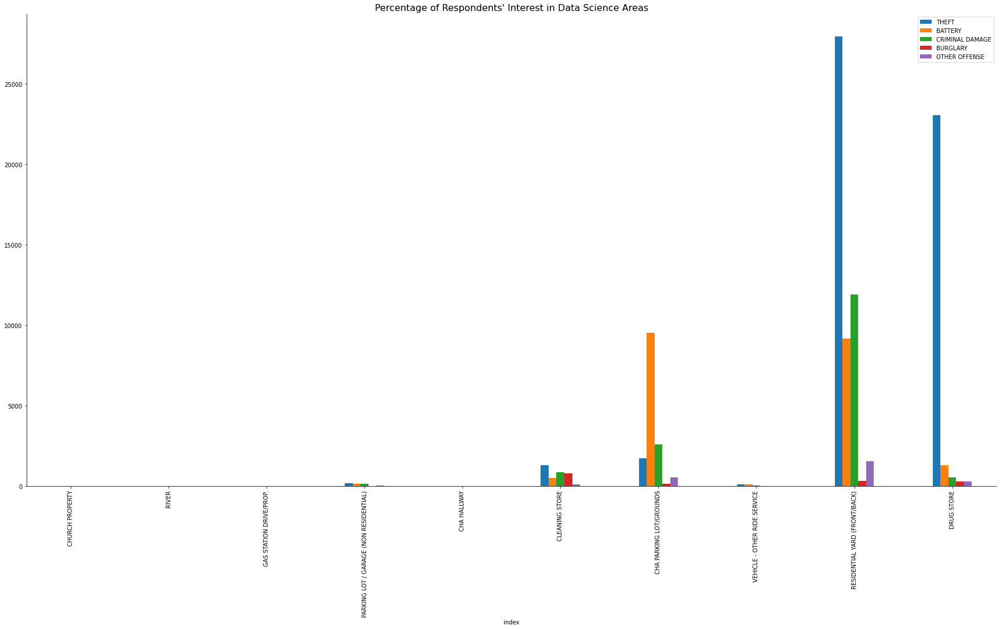

In [22]:
df_topFive = df_count4[['THEFT', 'BATTERY', 'CRIMINAL DAMAGE', 'BURGLARY', 'OTHER OFFENSE']].reset_index().sample(10)
ax = df_topFive.plot(x='index',kind='bar', width=0.4,figsize=(30,15))
pplt.title("Percentage of Respondents' Interest in Data Science Areas", fontsize = 16)
pplt.legend(fontsize = 10)
pplt.xticks(fontsize = 10)
pplt.yticks(fontsize = 10)
#pplt.gca().spines['left'].set_visible(False)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

<h4>2.3 Feature Selection</h4>

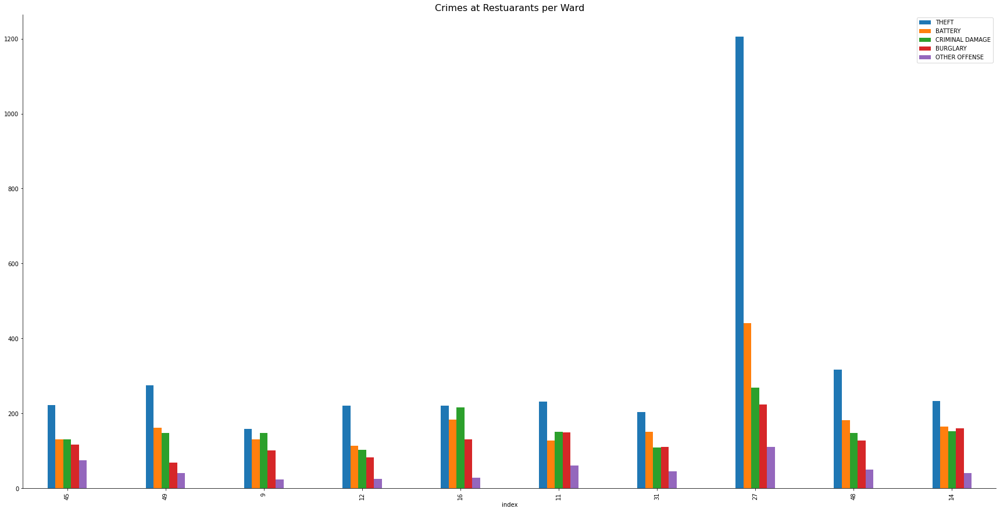

In [46]:
df_restaurants=df_crimes[df_crimes["Location Description"]=="RESTAURANT"].drop(["ID","IUCR","Location Description"], axis=1).dropna()

for w in wards:
    temp= df_restaurants[df_restaurants["Ward"]==w]
    x = pd.value_counts(temp['Primary Type'].values)
    for p in x.index:
        df_count[p][w] = x.get(p)

df_topFive = df_count[['THEFT', 'BATTERY', 'CRIMINAL DAMAGE', 'BURGLARY', 'OTHER OFFENSE']].reset_index().sample(10)
ax = df_topFive.plot(x='index',kind='bar', width=0.4,figsize=(30,15))
pplt.title("Crimes at Restuarants per Ward", fontsize = 16)
pplt.legend(fontsize = 10)
pplt.xticks(fontsize = 10)
pplt.yticks(fontsize = 10)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)


<h2>3. Exploratory Data Analysis</h2>
<h4></h4>
<h4></h4>

In [47]:
from sklearn.preprocessing import LabelEncoder

integer_encoded= df_restaurants

for _ in df_restaurants.columns:
    integer_encoded[_] = LabelEncoder().fit_transform(integer_encoded[_])

integer_encoded.head()

,Primary Type,Arrest,Beat,District,Ward,Community Area,Year
40,3,0,43,3,47,37,15
60,29,1,89,7,15,51,16
71,29,0,223,16,36,75,12
99,29,0,1,0,36,25,16
107,29,0,226,16,36,75,16


In [174]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD
svd = TruncatedSVD(n_components=6).fit(integer_encoded)
svd_data = svd.transform(integer_encoded)

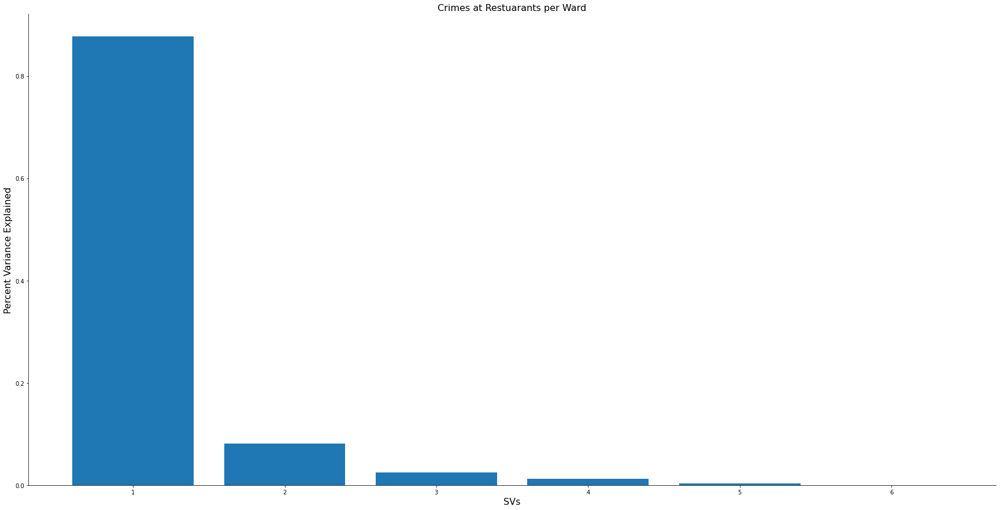

In [162]:
ax = pplt.figure(figsize=(30,15))
pplt.bar(x=list(range(1,len(svd.explained_variance_ratio_)+1)), height=svd.explained_variance_ratio_)
pplt.xlabel('SVs', fontsize=16)
pplt.ylabel('Percent Variance Explained', fontsize=16)
pplt.title("Crimes at Restuarants per Ward", fontsize = 16)

pplt.xticks(fontsize = 10)
pplt.yticks(fontsize = 10)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

In [153]:
svd_data.explained_variance_ratio_.sum()

0.9999845983672773

In [155]:
svd_data.singular_values_

array([57665.39767136, 10401.00033677,  5412.97539386,  3743.9706814 ,
        1999.99729364,   600.75707604])

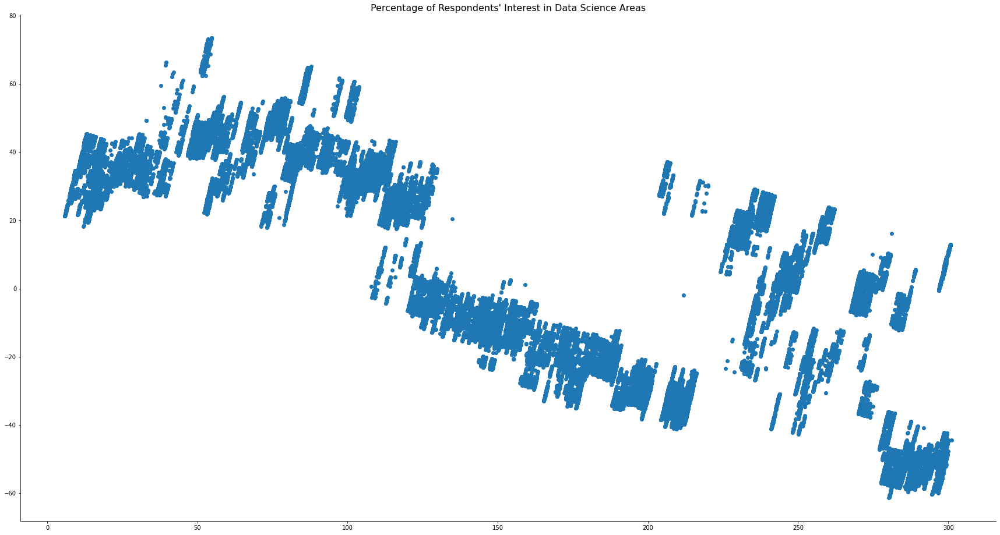

In [181]:
ax = pplt.figure(
        figsize=(30,16))
pplt.scatter(svd_data[:,0],svd_data[:,1],label='True Position')
pplt.title("Percentage of Respondents' Interest in Data Science Areas", 
        fontsize = 16)
pplt.xticks(fontsize = 10)
pplt.yticks(fontsize = 10)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

In [226]:
from sklearn.cluster import KMeans
import matplotlib.gridspec as gridspec

k = [3,4,5,10,20,24,50,78,100,304]
centers =[]
labels =[]
inertia =[]


fig = pplt.figure(figsize=(30,30),constrained_layout=True)
spec = gridspec.GridSpec(ncols=2, nrows=5, figure=ax)
grid =[(0,0),(0,1),(1,0),(1,1),(2,0),(2,1),(3,0),(3,1),(4,0),(4,1)]

for i in range(len(k)):
    KM = KMeans(n_clusters=k[i]).fit(svd_data)
    centers.append(KM.cluster_centers_)
    labels.append(KM.labels_)
    inertia.append(KM.inertia_)

    ax= fig.add_subplot(spec[grid[i]])
    ax.scatter(svd_data[:,0],svd_data[:,1],label='True Position',c=labels[i])
    pplt.title("KMeans = 12", fontsize = 16)
    pplt.xticks(fontsize = 10)
    pplt.yticks(fontsize = 10)
    pplt.gca().spines['right'].set_visible(False)
    pplt.gca().spines['top'].set_visible(False)

pplt.show()

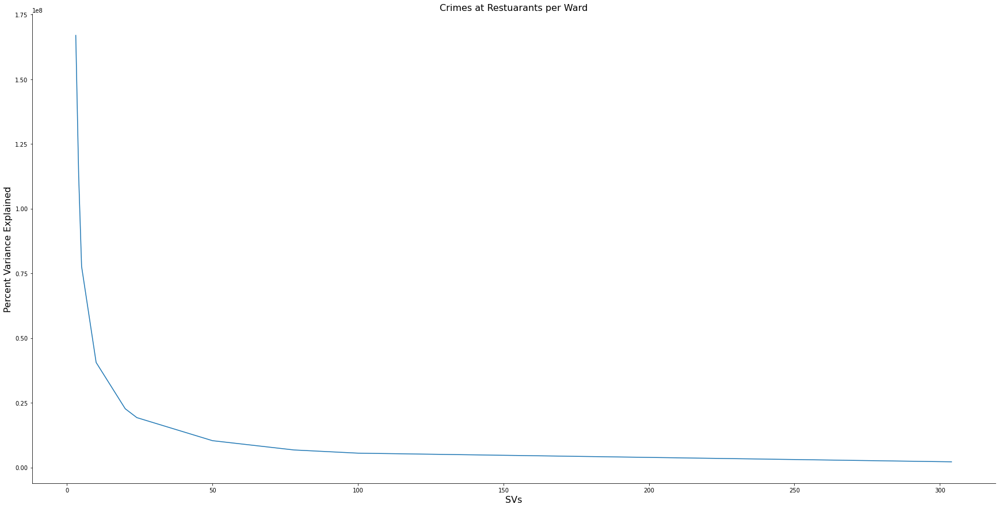

In [199]:
ax = pplt.figure(figsize=(30,15))
pplt.plot(k,inertia)
pplt.xlabel('SVs', fontsize=16)
pplt.ylabel('Percent Variance Explained', fontsize=16)
pplt.title("Crimes at Restuarants per Ward", fontsize = 16)
pplt.xticks(fontsize = 10)
pplt.yticks(fontsize = 10)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

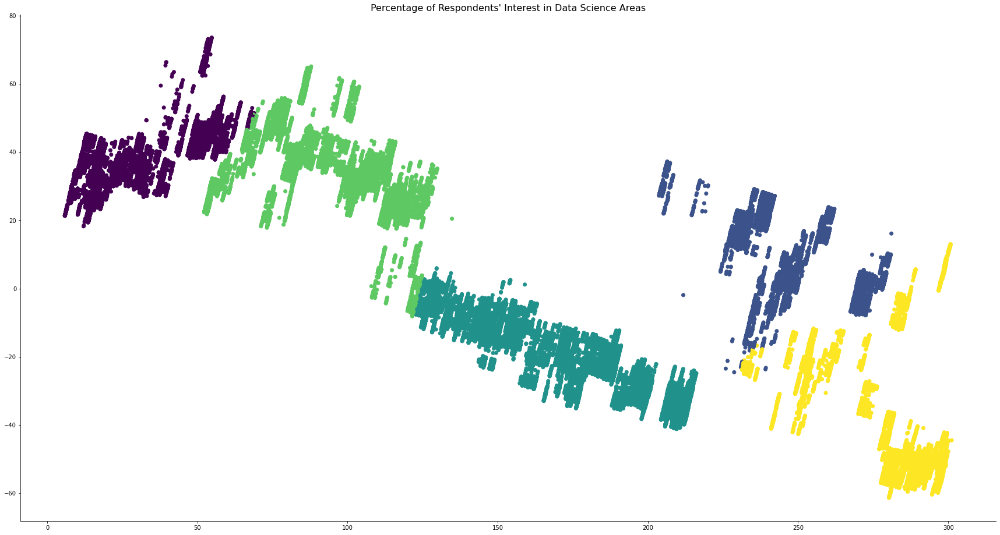

In [230]:
KM = KMeans(n_clusters=k[2]).fit(svd_data)
ax = pplt.figure(
        figsize=(30,16))
pplt.scatter(svd_data[:,0],svd_data[:,1],label='True Position',c=labels[2])
pplt.title("Percentage of Respondents' Interest in Data Science Areas", 
        fontsize = 16)
pplt.xticks(fontsize = 10)
pplt.yticks(fontsize = 10)
pplt.gca().spines['right'].set_visible(False)
pplt.gca().spines['top'].set_visible(False)

<h2>5. Conclusion</h2>


<h2>6. Future improvements</h2>
The reason behgind many the issues was inexperience when handling the dataset. Dimesionality reduction on discrettte data must be handled differently that of continuous data. Thas t compounded with the large data set causes a plethora of issues beyond my current capabilities. Upon further reflection, the use of relative frequency of each value count may have been a better methodologuy to use. This potentially could have neggated the need for label encoding. Use of relative frequencices may allow for the use of Principle Component Analysis (PCA) for dimenionality reduction. Princple component analysis could then be used to better illustrate the explained variance of a given feature of the dataset.